In [1]:
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc

In [2]:
import sys
sys.path.append('../../')

from downstream.svg import detect_svg
from downstream.plotting import svgplot, gheatmap, crt_domain_edge

import utils

# Config

In [11]:
# set global rc parameters
# sc.settings.set_figure_params(vector_friendly=True)

utils.config_rc(dpi=300, font_size=5)
# mpl.rcParams
wk_root = os.path.abspath(os.path.join(os.getcwd(), os.pardir, os.pardir))

In [4]:
# IDC svg data result root path
data_root = utils.get_path('svg_wk_root', json_path=os.path.join(wk_root, '_data.json'))

adata = sc.read_h5ad(os.path.join(data_root, 'IDC/adata_IDC.h5ad'))
annotation =pd.read_csv(os.path.join(data_root, 'IDC/IDC1_annotations.csv')).set_index('spot')
cell2loc_ann = pd.read_csv(os.path.join(data_root, 'IDC/IDC_celltype_matrix.csv')).set_index('Unnamed: 0')

adata.obs['annotation'] = annotation
adata.obs['annotation'] = adata.obs['annotation'].astype('category')
adata.obsm['cell2loc'] = cell2loc_ann

In [5]:
adata

AnnData object with n_obs × n_vars = 4727 × 19437
    obs: 'in_tissue', 'array_row', 'array_col', 'pxl_col_in_fullres', 'pxl_row_in_fullres', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'SpaSEG_discrete_clusters', 'SpaSEG_clusters', 'spot_neighbors', 'annotation'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'SpaSEG_clusters_colors', 'metrics', 'pca', 'raw_domain_lr_means', 'spatial', 'spatial_neighbors'
    obsm: 'X_pca', 'cell_types', 'spatial', 'spot_lr_padj', 'spot_lr_score', 'cell2loc'
    varm: 'PCs'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [6]:
# adata.write_h5ad(os.path.join(wk_root, 'notebook/results/SVG/IDC_w_anno.h5ad'))

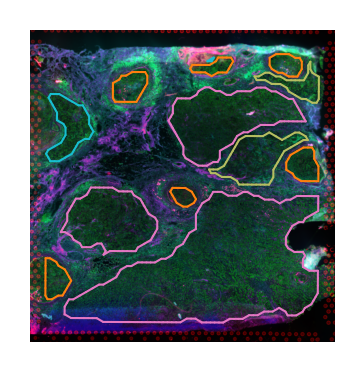

In [39]:
img_key = 'hires'
lib_id = list(adata.uns['spatial'].keys())[0]

scale_factor = adata.uns['spatial'][lib_id]['scalefactors'][f'tissue_{img_key}_scalef']

_palette = {'Benign hyperplasia':sc.pl.palettes.default_20[7], 
            'In situ':sc.pl.palettes.default_20[1], 
            'Invasive':sc.pl.palettes.default_20[6], 
            'Non-tumor':sc.pl.palettes.default_20[2], 'Unclassified tumor':sc.pl.palettes.default_20[8]}
fig,ax=plt.subplots(figsize=(3.5*utils.centimeter, 3.5*utils.centimeter))
sc.pl.spatial(adata, img_key=img_key,ax = ax,frameon=False, show=False, alpha_img=1)

for _anno in ['Benign hyperplasia', 'In situ', 'Invasive', 'Unclassified tumor']:
    domain_coords, domain_edges = crt_domain_edge(adata,
                                              target_domain=_anno,
                                              domain_labels='annotation',
                                              basis='spatial', alpha=350)
    for i, j in domain_edges:
        ax.plot(domain_coords[[i, j], 0] * scale_factor,
           domain_coords[[i, j], 1] * scale_factor,
           linestyle="-",
           linewidth=0.5,
           color=_palette[_anno])
plt.savefig(os.path.join(wk_root, f'notebook/results/IDC/img_annotation.pdf'), bbox_inches='tight', format='pdf', dpi=400)


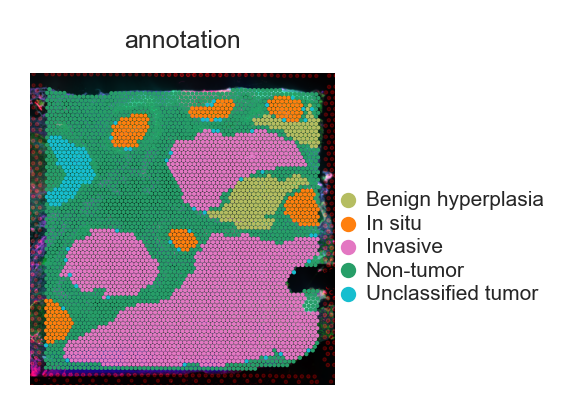

In [54]:
img_key = 'hires'
lib_id = list(adata.uns['spatial'].keys())[0]

scale_factor = adata.uns['spatial'][lib_id]['scalefactors'][f'tissue_{img_key}_scalef']

_palette = {'Benign hyperplasia':sc.pl.palettes.default_20[7], 
            'In situ':sc.pl.palettes.default_20[1], 
            'Invasive':sc.pl.palettes.default_20[6], 
            'Non-tumor':sc.pl.palettes.default_20[2], 'Unclassified tumor':sc.pl.palettes.default_20[8]}

fig,ax=plt.subplots(figsize=(3.5*utils.centimeter, 3.5*utils.centimeter))
sc.pl.spatial(adata, img_key=img_key,color='annotation',ax = ax,frameon=False, show=False, palette=_palette,size=1.5)
leg=ax.legend(loc='lower left', bbox_to_anchor=[0.98, 0.2], ncol=1, frameon=False,
           markerscale=0.6, labelspacing=0.2, fontsize=5,
          handleheight= 0.8, handlelength=0.1
         )
plt.savefig(os.path.join(wk_root, f'notebook/results/IDC/IDC_annotation.pdf'), bbox_inches='tight', format='pdf', dpi=400)

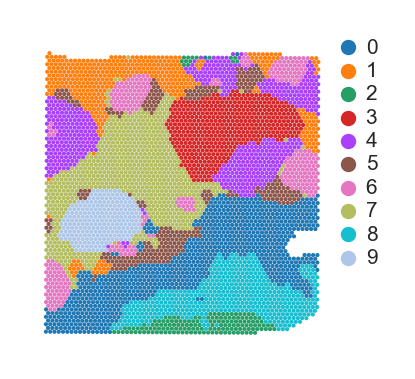

In [50]:
fig,ax=plt.subplots(figsize=(3.5*utils.centimeter, 3.5*utils.centimeter))
sc.pl.spatial(adata, img_key=None, color="SpaSEG_clusters",size=1.5,ax = ax,frameon=False, show=False, alpha=1)
ax.set_title(None)
leg=ax.legend(loc='lower left', bbox_to_anchor=[0.98, 0.2], ncol=1, frameon=False,
           markerscale=0.6, labelspacing=0.2, fontsize=5,
          handleheight= 0.8, handlelength=0.1
         )

plt.savefig(os.path.join(wk_root, f'notebook/results/IDC/IDC_SpaSEG_domains.pdf'), bbox_inches='tight', format='pdf', dpi=400)

In [11]:
adata.obs['cell2loc_cellltype'] = adata.obsm['cell2loc'].idxmax(axis=1)

In [17]:
domain_ct_cnt = adata.obs[['cell2loc_cellltype', 'SpaSEG_clusters']].groupby(['SpaSEG_clusters','cell2loc_cellltype']).size().unstack()
domain_ct_cnt_ = domain_ct_cnt.div(domain_ct_cnt.sum(axis=1), axis=0)
domain_ct_cnt_ = domain_ct_cnt_.iloc[[0,8,2,3,9,1,5,7,4,6],:]
domain_ct_cnt_

cell2loc_cellltype,B cells Memory,CAFs MSC iCAF-like,CAFs myCAF-like,Cancer Basal SC,Cancer Cycling,Cancer Her2 SC,Cancer LumA SC,Cancer LumB SC,Endothelial ACKR1,Endothelial Lymphatic LYVE1,Endothelial RGS5,Luminal Progenitors,Macrophage,Mature Luminal,Myoepithelial,PVL Differentiated,Plasmablasts,T cells CD4+
SpaSEG_clusters,,,,,,,,,,,,,,,,,,
0,0.000000,0.000000,0.004386,0.000000,0.412281,0.002193,0.410088,0.046053,0.000000,0.000000,0.004386,0.002193,0.086623,0.027412,0.000000,0.001096,0.003289,0.000000
8,0.000000,0.000000,0.003992,0.000000,0.584830,0.000000,0.309381,0.005988,0.000000,0.000000,0.000000,0.000000,0.000000,0.095808,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.256098,0.006098,0.146341,0.042683,0.000000,0.000000,0.000000,0.000000,0.006098,0.536585,0.006098,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.004158,0.000000,0.012474,0.002079,0.122661,0.713098,0.000000,0.000000,0.000000,0.004158,0.018711,0.118503,0.000000,0.000000,0.004158,0.000000
9,0.000000,0.000000,0.000000,0.000000,0.012146,0.016194,0.008097,0.882591,0.000000,0.000000,0.000000,0.000000,0.040486,0.036437,0.000000,0.000000,0.004049,0.000000
1,0.011287,0.031603,0.002257,0.002257,0.027088,0.000000,0.045147,0.117381,0.009029,0.002257,0.000000,0.209932,0.085779,0.406321,0.000000,0.004515,0.038375,0.006772
5,0.006557,0.006557,0.019672,0.000000,0.006557,0.003279,0.019672,0.000000,0.016393,0.000000,0.000000,0.068852,0.695082,0.016393,0.000000,0.000000,0.118033,0.022951
7,0.000000,0.003911,0.001304,0.000000,0.018253,0.010430,0.172099,0.451108,0.005215,0.000000,0.000000,0.027379,0.059974,0.172099,0.000000,0.000000,0.078227,0.000000
4,0.000000,0.001783,0.005348,0.000000,0.005348,0.012478,0.130125,0.459893,0.000000,0.000000,0.000000,0.007130,0.119430,0.221034,0.000000,0.000000,0.035651,0.001783


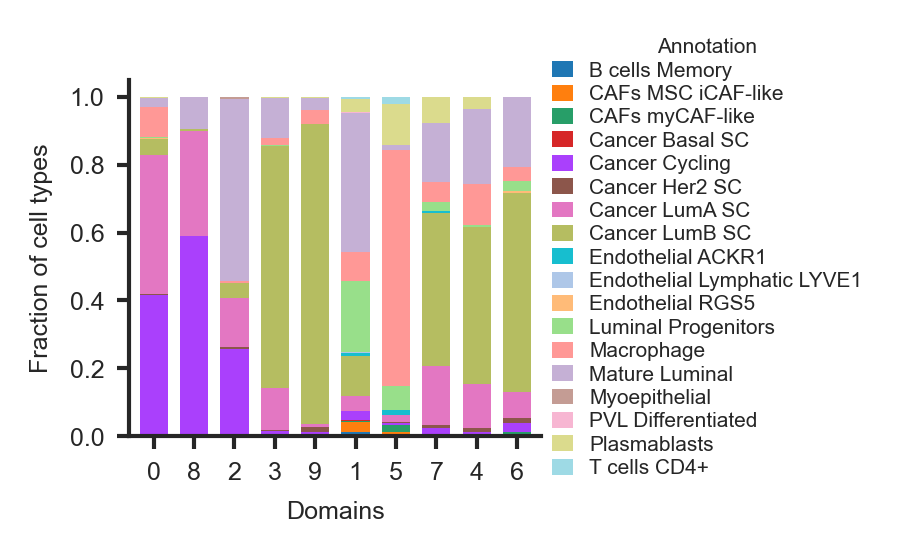

In [21]:
fig,ax = plt.subplots(figsize=(utils.centimeter*4.5, utils.centimeter*4)) 
domain_ct_cnt_.plot(kind='bar', stacked=True,ax=ax, color=sc.pl.palettes.default_20[:domain_ct_cnt_.shape[1]],edgecolor=None, linewidth=0, width=0.7)
ax.tick_params(direction='out', length=3, pad=3, width=1)
leg = ax.legend(loc='center left', bbox_to_anchor=[0.98, 0.5], ncol=1, frameon=False, 
           markerscale=0.6, labelspacing=0.2, fontsize=5,
          handleheight= 0.8, handlelength=1,title='Annotation')
leg.get_title().set_fontsize('5')
sns.despine()
ax.set_xticklabels(ax.get_xticklabels(),rotation=0)
ax.set_xlabel('Domains')
ax.set_ylabel('Fraction of cell types')
plt.savefig(os.path.join(wk_root, f'notebook/results/IDC/IDC_frac_celltype_domains.pdf'), bbox_inches='tight', format='pdf', dpi=400)

In [23]:
domain_ct_cnt = adata.obs[['annotation', 'SpaSEG_clusters']].groupby(['SpaSEG_clusters','annotation']).size().unstack()
domain_ct_cnt_ = domain_ct_cnt.div(domain_ct_cnt.sum(axis=1), axis=0)
domain_ct_cnt_ = domain_ct_cnt_.iloc[[0,8,2,3,9,1,5,7,4,6],:]
domain_ct_cnt_

annotation,Benign hyperplasia,In situ,Invasive,Non-tumor,Unclassified tumor
SpaSEG_clusters,,,,,
0,0.000000,0.000000,0.823465,0.169956,0.006579
8,0.000000,0.000000,0.940120,0.053892,0.005988
2,0.000000,0.000000,0.560976,0.426829,0.012195
3,0.008316,0.000000,0.839917,0.133056,0.018711
9,0.000000,0.000000,0.898785,0.080972,0.020243
1,0.006772,0.006772,0.004515,0.979684,0.002257
5,0.032787,0.000000,0.088525,0.875410,0.003279
7,0.001304,0.018253,0.026076,0.949153,0.005215
4,0.426025,0.062389,0.010695,0.269162,0.231729


In [24]:
_palette = {'Benign hyperplasia':sc.pl.palettes.default_20[7], 
            'In situ':sc.pl.palettes.default_20[1], 
            'Invasive':sc.pl.palettes.default_20[6], 
            'Non-tumor':sc.pl.palettes.default_20[2], 'Unclassified tumor':sc.pl.palettes.default_20[8]}

cols = [sc.pl.palettes.default_20[7], sc.pl.palettes.default_20[1], 
        sc.pl.palettes.default_20[6], sc.pl.palettes.default_20[2], sc.pl.palettes.default_20[8]]

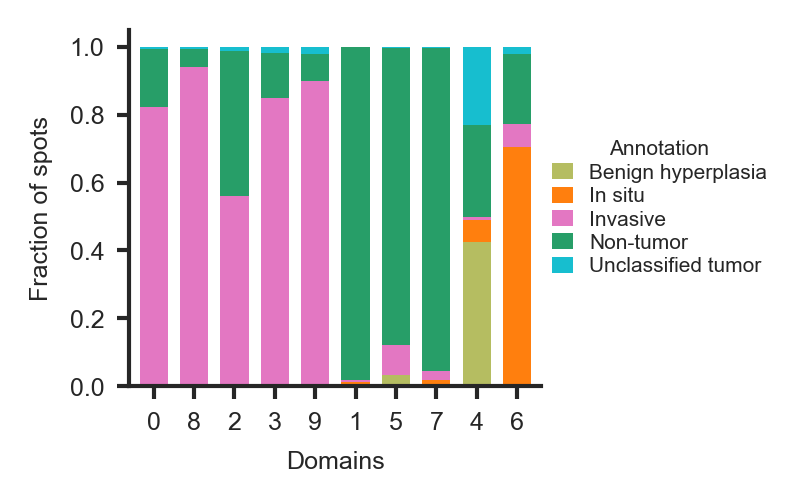

In [25]:
fig,ax = plt.subplots(figsize=(utils.centimeter*4.5, utils.centimeter*4)) 
domain_ct_cnt_.plot(kind='bar', stacked=True,ax=ax, color=cols,edgecolor=None, linewidth=0, width=0.7)
ax.tick_params(direction='out', length=3, pad=3, width=1)
leg = ax.legend(loc='center left', bbox_to_anchor=[0.98, 0.5], ncol=1, frameon=False, 
           markerscale=0.6, labelspacing=0.2, fontsize=5,
          handleheight= 0.8, handlelength=1,title='Annotation')
leg.get_title().set_fontsize('5')
sns.despine()
ax.set_xticklabels(ax.get_xticklabels(),rotation=0)
ax.set_xlabel('Domains')
ax.set_ylabel('Fraction of spots')
plt.savefig(os.path.join(wk_root, f'notebook/results/IDC/IDC_frac_spot_domains.pdf'), bbox_inches='tight', format='pdf', dpi=400)

In [26]:
import numpy as np
from sklearn import metrics

"""
refer: https://stats.stackexchange.com/questions/95731/how-to-calculate-purity
"""
def purity_score(y_true, y_pred):
    # compute contingency matrix (also called confusion matrix)
    contingency_matrix = metrics.cluster.contingency_matrix(y_true, y_pred)
    # return purity
    return np.sum(np.amax(contingency_matrix, axis=0)) / np.sum(contingency_matrix) 

In [27]:
y_true = adata.obs['annotation'].cat.codes.values
y_pred = adata.obs['SpaSEG_clusters'].values

purity_score(y_true, y_pred)

0.8146816162470912

In [28]:
metrics.adjusted_rand_score(y_true, y_pred)

0.2233603750533198

In [29]:
metrics.normalized_mutual_info_score(y_true, y_pred)

0.3914931556198518

# Detect SVG

In [30]:
# find SVG without filtering
# The purpose for doing this in this way is to analysis conveniently.

# svgs,adata_ = detect_svg(adata, target_domains='all',do_filter=False)
# svgs.to_csv(os.path.join(wk_root, 'notebook/results/SVG/svg_IDC_All_Domain_NotFilter.csv'), index=False)


../../svg/svg.py:44: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_.obs[domain_labels] = adata_.obs[domain_labels].astype(str).astype('category')


rank genes....
rank genes done


Detect SVGs for target domains: 100%|██████████| 10/10 [00:44<00:00,  4.41s/it]


In [27]:
d_svg = pd.read_csv(os.path.join(data_root, 'IDC/svg_IDC_All_Domain_NotFilter.csv'))

In [29]:
d_svg[d_svg['gene']=='MKI67']

,gene,pvals_adj,log2_fc,in_fraction,out_fraction,max_fraction,in_expr_mean_log,in_expr_cv,max_expr_mean_log,max_expr_cv,max_expr_domain,log2_fc_in_max,domain,cv_r,in_out_fraction,in_max_fraction
18737,MKI67,3.933897e-01,-0.910182,0.348178,0.357812,0.561404,0.269059,1.531854,0.574267,1.175545,0,-1.696597,9,1.303101,0.973074,0.620192
38773,MKI67,1.651349e-13,-1.747985,0.201426,0.378301,0.561404,0.180014,2.352793,0.574267,1.175545,0,-2.426864,4,2.001449,0.532450,0.358790
39008,MKI67,1.273269e-31,1.070481,0.561404,0.308519,0.550898,0.574267,1.175545,0.712022,1.200481,8,-0.637547,0,0.979228,1.819672,1.019069
77517,MKI67,1.143357e-04,-1.418826,0.260116,0.364985,0.561404,0.208599,1.989575,0.574267,1.175545,0,-2.167013,6,1.692471,0.712674,0.463331
77834,MKI67,2.501372e-01,1.788973,0.341463,0.357879,0.561404,0.764970,1.708095,0.574267,1.175545,0,0.878110,2,1.453024,0.954132,0.608232
97214,MKI67,7.236093e-24,1.703116,0.550898,0.334359,0.561404,0.712022,1.200481,0.574267,1.175545,0,0.637547,8,1.021213,1.647626,0.981287
134996,MKI67,6.516624e-03,-0.541175,0.280313,0.372222,0.561404,0.330934,1.856456,0.574267,1.175545,0,-1.287342,7,1.579231,0.753079,0.499307
154594,MKI67,4.686656e-06,-1.065140,0.180328,0.369516,0.561404,0.249990,2.487959,0.574267,1.175545,0,-1.835713,5,2.116431,0.488011,0.321209
172250,MKI67,2.156558e-01,-0.451103,0.313770,0.361811,0.561404,0.338933,1.857597,0.574267,1.175545,0,-1.238199,1,1.580201,0.867219,0.558902
193817,MKI67,7.397852e-03,-0.929529,0.305613,0.363165,0.561404,0.271894,1.755190,0.574267,1.175545,0,-1.676524,3,1.493087,0.841527,0.544374


In [32]:
df_group = d_svg.copy()

max_p=0.05
max_in_p=0.05
min_in_frac=0.75
min_log2fc=1.5
min_log2fc_in_max=1.5

min_in_out_frac=1.
min_in_max_frac=0.95 

cut_min_in_out_frac=1.2
cut_min_in_max_frac=1.2

cut_min_log2fc_in_max=3.0
cut_min_log2fc=3.0
cut_min_in_expr_cv=0.6
cut_max_cv_r = 1

min_high_log2_fc=8

pre_req = (
    (df_group['pvals_adj'] < max_p) &
    (df_group['in_fraction'] > min_in_frac) &
    (np.abs(df_group['log2_fc_in_max']) > min_log2fc_in_max) &
    (df_group['log2_fc'] > min_log2fc) &
    (df_group['in_max_fraction'] > min_in_max_frac) &
    (df_group['in_out_fraction'] > min_in_out_frac)
)

df_group=df_group.loc[pre_req]
                     
cond1_cut = ((df_group['in_out_fraction']> cut_min_in_out_frac) | (df_group['in_max_fraction']> cut_min_in_max_frac))
cond2_cut = ((df_group['log2_fc']>cut_min_log2fc) &
             (df_group['log2_fc_in_max']>cut_min_log2fc_in_max) & # must greater than 0
             # (df_group['max_fraction']< 1) & 
             (df_group['in_expr_cv']<cut_min_in_expr_cv)&
             (df_group['cv_r']<cut_max_cv_r))

cond3_cut= (df_group['log2_fc']> min_high_log2_fc) 

df_group=df_group.loc[cond1_cut|cond2_cut|cond3_cut]

print(df_group.shape[0])
df_group

209


,gene,pvals_adj,log2_fc,in_fraction,out_fraction,max_fraction,in_expr_mean_log,in_expr_cv,max_expr_mean_log,max_expr_cv,max_expr_domain,log2_fc_in_max,domain,cv_r,in_out_fraction,in_max_fraction
0,KRT37,6.365542e-110,5.671123,0.983806,0.362500,0.718360,1.574311,0.551117,0.906305,0.972988,4,3.736552,9,0.566416,2.713947,1.369516
1,IFI27,1.643090e-108,25.852777,1.000000,0.996205,1.000000,3.524937,0.308061,2.854111,0.357196,0,23.938130,9,0.862441,1.003809,1.000000
2,IFI6,9.202197e-93,16.513820,1.000000,0.993973,1.000000,3.198240,0.297873,2.630351,0.641901,6,15.308098,9,0.464048,1.006063,1.000000
3,MCCD1,9.202197e-93,4.628392,0.971660,0.427232,0.668449,1.471550,0.609583,0.735205,0.989912,4,3.818026,9,0.615795,2.274314,1.453603
4,ACADSB,8.229782e-83,6.099033,0.987854,0.674554,0.904624,1.884961,0.592208,1.411233,0.752676,6,3.646236,9,0.786804,1.464456,1.092005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174865,CRIP1,6.512685e-47,6.420517,1.000000,0.996232,1.000000,3.040425,0.287749,2.542252,0.336235,9,11.838586,3,0.855797,1.003783,1.000000
174868,RBBP7,5.904085e-46,1.901418,0.860707,0.585963,0.757085,1.079890,0.778977,0.743071,0.840510,9,1.574193,3,0.926791,1.468875,1.136869
174873,CST3,6.062113e-43,3.428544,1.000000,0.968676,0.997110,2.302533,0.396045,1.970323,0.500903,6,4.080592,3,0.790663,1.032336,1.002899
174877,IER3,5.971702e-42,2.049334,0.952183,0.776024,0.979757,1.553474,0.606283,1.764008,0.560735,9,-1.621990,3,1.081229,1.227001,0.971856


In [33]:
len(df_group['gene'].unique())

159

In [13]:
df_group.to_csv(os.path.join(wk_root, 'notebook/results/SVG/svg_IDC_All_Domain_Filtered_0.75_8.csv'), index=False)

# Plot SVGs

In [6]:
df_group = pd.read_csv(os.path.join(data_root, 'IDC/svg_IDC_All_Domain_Filtered_0.75_8.csv'))

In [7]:
df_group['domain'].value_counts()

1    40
5    34
3    31
9    28
0    22
8    21
4    15
6     8
7     6
2     4
Name: domain, dtype: int64

In [8]:
# sort
# _group_df =  df_group.sort_values(by=['domain','log2_fc'],ascending=[True, False], ignore_index=True)
_group_df =  df_group.sort_values(by=['log2_fc','in_expr_mean_log','domain'],ascending=[True,True,False], ignore_index=True)


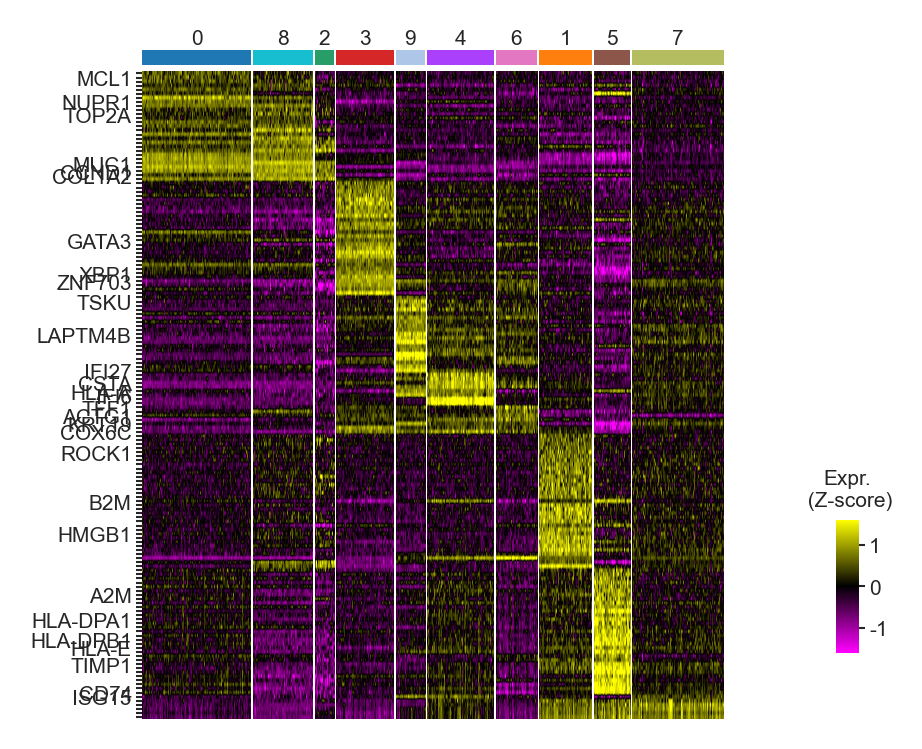

In [11]:

# get all genes based on domain
domain_genes = _group_df.groupby('domain')['gene'].apply(list).to_dict()
#
# ananotation_domain_map = {'Invasive':[0,2,3,8,9], 'Non-tumor':[1,5,7],'In situ':[6],'others':[4]}
domain_order=[0,8,2,3,9,4,6,1,5,7]

# 
_palette = dict(zip(range(len(domain_order)), sc.pl.palettes.default_20[:len(domain_order)]))

# adata
_adata_std_scale = adata.copy()
sc.pp.scale(_adata_std_scale, max_value=10)

from matplotlib.colors import LinearSegmentedColormap
clist=['magenta','black','yellow']
hmap_cmap = LinearSegmentedColormap.from_list('gene_cmap',clist,N=256)

gheatmap(_adata_std_scale, domain_genes, domain_key='SpaSEG_clusters', 
         palette=_palette, fig_w_cm=utils.centimeter*6.35, wspace=0.035,
         fig_h_cm=utils.centimeter*7.5, vmin=-1.6, vmax=1.6, cbar_map=hmap_cmap, domain_order=domain_order, yticklabelsize=5, interpolation=None,
         show_genes=list(set(['NUPR1','MUC1','CCND1','TOP2A','XBP1','GATA3','ZNF703','TFF1','IFI27','IFI6','ISG15','HLA-A','CD74','HLA-E','B2M', 'COX6C','CSTA',
                            'ACTG1','LAPTM4B','KRT19','TSKU','HMGB1','ROCK1','A2M','TIMP1','HLA-DPB1','HLA-DPA1','MCL1','COL1A2'])))
# ['NUPR1','MUC1','CCND1','HSP90AA1','TOP2A','IGFBP5','IGFBP2','XBP1','GATA3','ZNF703','IFI6','ISG15','HLA-A','LAPTM4B','CD74','HLA-E',
# 'LAPTM5','C3','HLA-DRA','IGHG3','IGKC','SAMHD1','ROCK1','SYNE2','TFF3','TFF1']
plt.savefig(os.path.join(wk_root, "notebook/results/IDC/IDC_heatmap.pdf"), bbox_inches='tight', format='pdf', dpi=600)

In [24]:
domain_map = {'Invasive':[0,2,3,8,9], 'Non-tumor':[1,5,7],'In situ':[6],'others':[4]}
domain_ananotation_map={0:'Invasive', 2:'Invasive',3:'Invasive',8:'Invasive',9:'Invasive', 1:'Non-tumor',5:'Non-tumor',7:'Non-tumor', 6: 'In situ', 4:'others'}
_group_df['anno']=_group_df['domain'].map(domain_ananotation_map)
_group_df

,gene,pvals_adj,log2_fc,in_fraction,out_fraction,max_fraction,in_expr_mean_log,in_expr_cv,max_expr_mean_log,max_expr_cv,max_expr_domain,log2_fc_in_max,domain,cv_r,in_out_fraction,in_max_fraction,anno
0,KRT8,7.900278e-284,27.709925,1.000000,0.996068,1.000000,3.719378,0.286022,3.155032,0.327447,9,25.658266,0,0.873491,1.003947,1.000000,Invasive
1,MUC1,1.538576e-235,26.013374,1.000000,0.996855,1.000000,3.651836,0.301921,2.536606,0.533440,6,37.378290,0,0.565989,1.003155,1.000000,Invasive
2,CXCL14,4.464584e-298,19.659601,0.997807,0.862385,0.998004,2.981734,0.540603,2.807426,0.524688,8,4.551357,0,1.030333,1.157032,0.999803,Invasive
3,KRT18,2.223482e-252,16.910656,1.000000,0.991350,1.000000,3.320684,0.303829,2.903895,0.325466,9,13.610677,0,0.933521,1.008726,1.000000,Invasive
4,CCND1,7.652129e-230,11.756152,1.000000,0.975098,1.000000,2.838998,0.377968,2.009459,0.419150,9,13.908879,0,0.901749,1.025538,1.000000,Invasive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204,S100G,2.146996e-34,2.751531,0.979757,0.657813,0.942959,1.703007,0.670696,2.152308,0.701441,4,-4.508488,9,0.956168,1.489417,1.039024,Invasive
205,VAT1,6.878047e-39,2.488939,0.943320,0.664286,0.806358,1.313241,0.677473,0.884715,0.837025,6,2.169241,9,0.809383,1.420051,1.169852,Invasive
206,TSKU,1.485858e-47,2.382971,0.862348,0.360268,0.524064,0.894360,0.739739,0.543073,1.271007,4,1.618185,9,0.582010,2.393631,1.645501,Invasive
207,HEBP1,3.591405e-26,1.746144,0.931174,0.631027,0.896613,1.250928,0.677204,1.594018,0.699066,4,-2.158511,9,0.968727,1.475649,1.038546,Invasive


In [25]:
_group_df.to_csv(os.path.join(wk_root, "notebook/results/SVG/svg_IDC.csv"), index=False)

# SVG plot

In [5]:
_group_df=pd.read_csv(os.path.join(data_root, "IDC/svg_IDC.csv"))

In [6]:
from matplotlib.colors import ListedColormap,LinearSegmentedColormap

# clist=['#66c2a5','#fee08b','#d73027']
# clist=['#d01c8b','#f1b6da','#f7f7f7','#4dac26'][::-1]
# clist = ['#d73027','#f46d43','#fdae61','#fee090','#e0f3f8','#abd9e9','#74add1'][::-1]
clist=['#a50026','#d73027','#f46d43','#fdae61','#fee090','#e0f3f8','#abd9e9','#74add1','#4575b4'][::-1]
newcmp_r_svg_pattern = LinearSegmentedColormap.from_list('gene_cmap',clist,N=256)

In [7]:

# get SVG in multiple domains
_group_df['domains'] = [','.join(_group_df[_group_df['gene']==x]['domain'].values.astype(str)) for x in _group_df['gene'].tolist()]

_group_df['domainss'] = [','.join(list(set(list(_group_df[_group_df['gene']==x]['domain'].values.astype(str))+
                                  list(_group_df[_group_df['gene']==x]['max_expr_domain'].values.astype(str))))) for x in _group_df['gene'].tolist()]

# remove dupliates
svgs_1 = _group_df.drop_duplicates(subset=['domains','gene'], keep='first')
svgs_1.sort_values(by=['domain','gene'], inplace=True, ignore_index=True)
svgs_1['domain'] = svgs_1['domain'].astype('string') 

<ipython-input-7-59057bb840e6>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  svgs_1.sort_values(by=['domain','gene'], inplace=True, ignore_index=True)
<ipython-input-7-59057bb840e6>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  svgs_1['domain'] = svgs_1['domain'].astype('string')


In [8]:
svgs_1

,gene,pvals_adj,log2_fc,in_fraction,out_fraction,max_fraction,in_expr_mean_log,in_expr_cv,max_expr_mean_log,max_expr_cv,max_expr_domain,log2_fc_in_max,domain,cv_r,in_out_fraction,in_max_fraction,anno,domains,domainss
0,CCND1,7.652129e-230,11.756152,1.000000,0.975098,1.000000,2.838998,0.377968,2.009459,0.419150,9,13.908879,0,0.901749,1.025538,1.000000,Invasive,"0,2,8","2,8,0,9"
1,CRIP1,1.087902e-116,7.611144,0.998904,0.996068,1.000000,3.052793,0.272077,2.542252,0.336235,9,12.214089,0,0.809187,1.002847,0.998904,Invasive,"0,3,8","3,8,0,9"
2,CXCL14,4.464584e-298,19.659601,0.997807,0.862385,0.998004,2.981734,0.540603,2.807426,0.524688,8,4.551357,0,1.030333,1.157032,0.999803,Invasive,"0,2,8","2,8,0"
3,CYC1,1.228224e-64,1.515320,0.835526,0.598427,0.724696,1.026697,0.753115,0.701075,0.945617,9,1.504917,0,0.796427,1.396204,1.152933,Invasive,0,"0,9"
4,FTL,3.394603e-32,5.194689,1.000000,0.998427,1.000000,3.236484,0.508637,2.831866,0.535392,9,12.215270,0,0.950027,1.001575,1.000000,Invasive,0,"0,9"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154,SERPINA5,3.772915e-53,2.968988,0.809717,0.296875,0.554367,0.939387,0.903894,0.563831,1.274077,4,1.727602,9,0.709450,2.727466,1.460614,Invasive,9,"4,9"
155,SLC9A3R1,1.563896e-50,5.647371,1.000000,0.975223,1.000000,2.452937,0.341234,2.240706,0.469146,6,3.206644,9,0.727351,1.025406,1.000000,Invasive,9,"6,9"
156,TSKU,1.485858e-47,2.382971,0.862348,0.360268,0.524064,0.894360,0.739739,0.543073,1.271007,4,1.618185,9,0.582010,2.393631,1.645501,Invasive,9,"4,9"
157,VAT1,6.878047e-39,2.488939,0.943320,0.664286,0.806358,1.313241,0.677473,0.884715,0.837025,6,2.169241,9,0.809383,1.420051,1.169852,Invasive,9,"6,9"


In [14]:
# geness_ = ['CCND1', 'MUC1','IFI6','GATA3','IGHG3','CD74','C3','XBP1','ZNF703','IGFBP5','COX6C','COL1A2','HLA-A','LAPTM4B','SAMHD1']
geness_ = ['MUC1','CCND1','GATA3','XBP1','ZNF703','IFI27','HLA-A','TIMP1','CD74']

_t_gene_df = svgs_1[svgs_1['gene'].isin(geness_)]

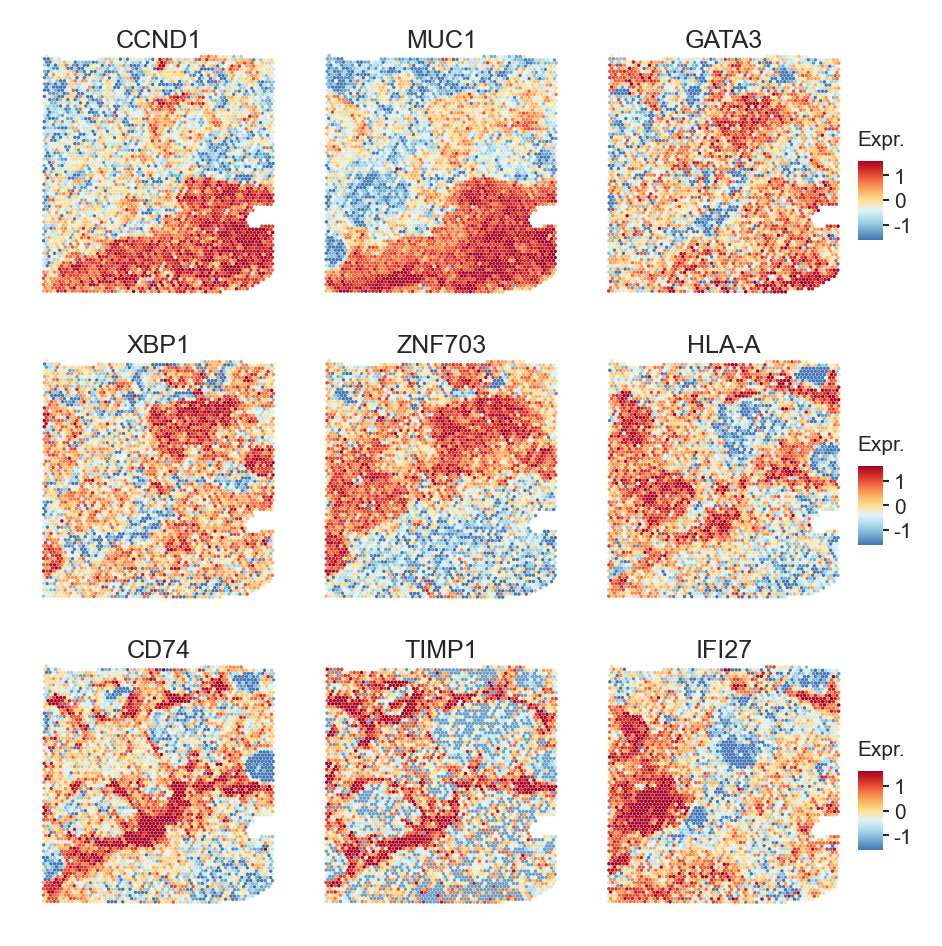

In [16]:
svgplot(adata, genes=_t_gene_df['gene'].tolist(), frameon=False, panel_cbar=False, target_domain=_t_gene_df['domains'].tolist(),cbar_wid_r=0.1, ncols=3,add_edge=False,
        axes_w_cm=3, size=1.5, domain_edge_alpha=200,img_key=None, cmap=newcmp_r_svg_pattern, wspace=0.001, hspace=0.01,title_w_domain=False,vmin=-1.6,
            vmax=1.6)
plt.savefig(os.path.join(wk_root, f'notebook/results/IDC/svg_IDC_Toshow.pdf'), bbox_inches='tight', format='pdf', dpi=400)

In [58]:
cand_genes = ['ERBB2','ESR1','PGR','PTPRC','CD4','CD8A','CD14','CD68','IGHG3','MKI67','MUC1','COL1A2','ZNF703','GRB2','BAMBI',
             'TRAF6']

svg_list = svgs_1[svgs_1['gene'].isin(cand_genes)]

In [59]:
svg_list

,gene,pvals_adj,log2_fc,in_fraction,out_fraction,max_fraction,in_expr_mean_log,in_expr_cv,max_expr_mean_log,max_expr_cv,max_expr_domain,log2_fc_in_max,domain,cv_r,in_out_fraction,in_max_fraction,anno,domains
13,MUC1,1.538576e-235,26.013374,1.000000,0.996855,1.000000,3.651836,0.301921,2.536606,0.533440,6,37.378290,0,0.565989,1.003155,1.000000,Invasive,"0,8"
41,IGHG3,4.446247e-68,8.071256,0.997743,0.908497,0.996089,3.010971,1.331390,3.507644,1.770501,7,-18.845102,1,0.751985,1.098235,1.001661,Non-tumor,"1,5,7"
62,COL1A2,1.396558e-26,10.021895,0.969512,0.947622,0.996008,2.765121,0.577781,2.842599,0.629529,8,-1.845693,2,0.917800,1.023100,0.973398,Invasive,"2,8"
72,GRB2,1.628690e-80,2.994927,0.908524,0.654263,0.872832,1.407987,0.684352,1.063129,0.793629,6,1.887684,3,0.862307,1.388622,1.040892,Invasive,3
91,ZNF703,1.914796e-149,9.855505,1.000000,0.942770,0.991903,2.625747,0.342447,2.474769,0.323798,9,2.792971,3,1.057594,1.060704,1.008163,Invasive,3


In [ ]:
# svgplot(adata, genes=, frameon=False, panel_cbar=False, target_domain=_target_domain[i],cbar_wid_r=0.1, ncols=6,add_edge=False,
#         axes_w_cm=3, size=1.5, domain_edge_alpha=200,img_key=None, cmap=newcmp_r_svg_pattern, wspace=0.001, hspace=0.01,title_w_domain=True)

In [9]:
def to_matrix(l, n):
    return [l[i:i+n] for i in range(0, len(l), n)]
    

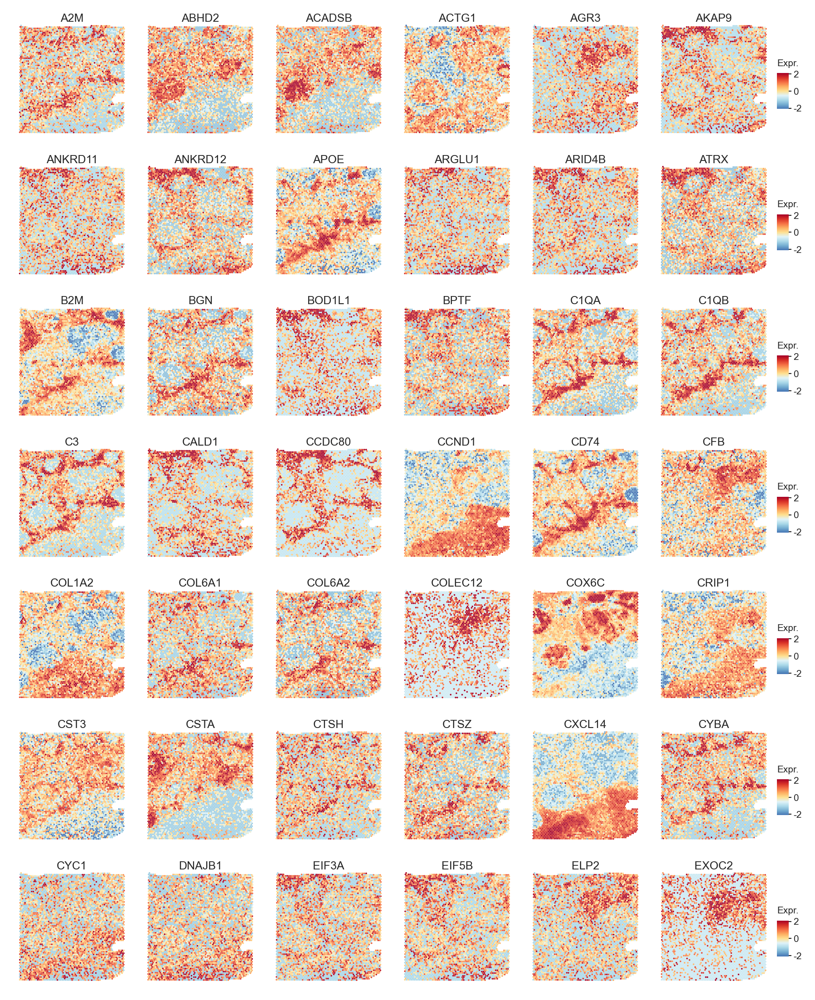

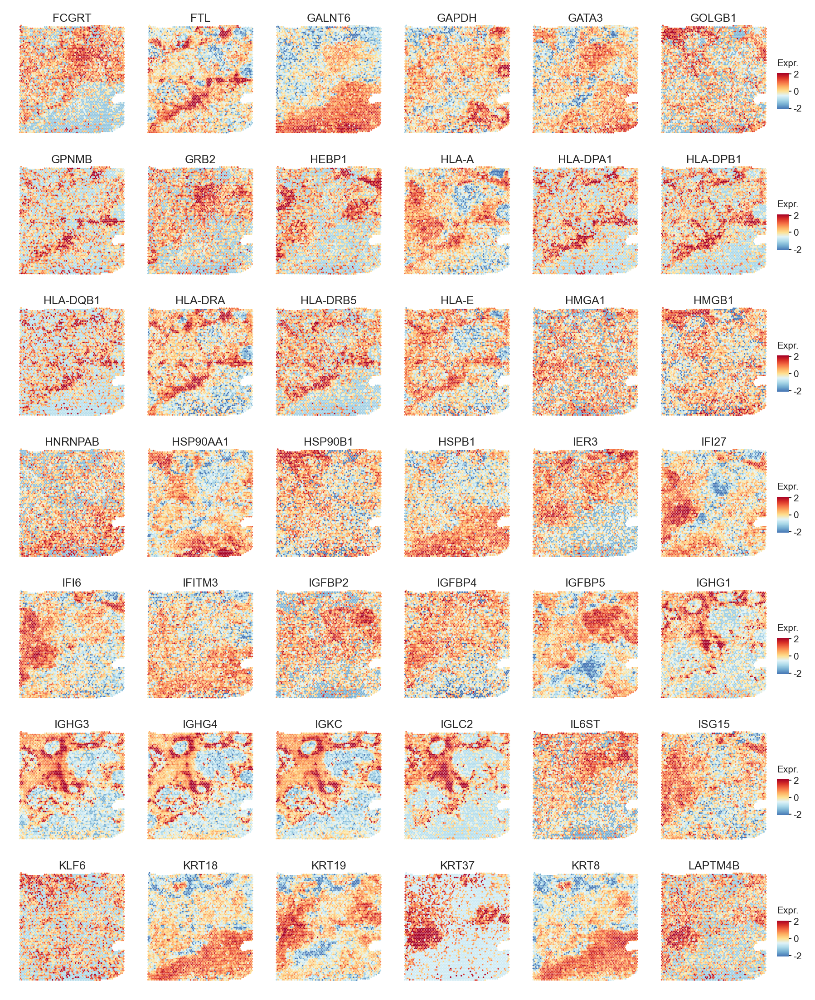

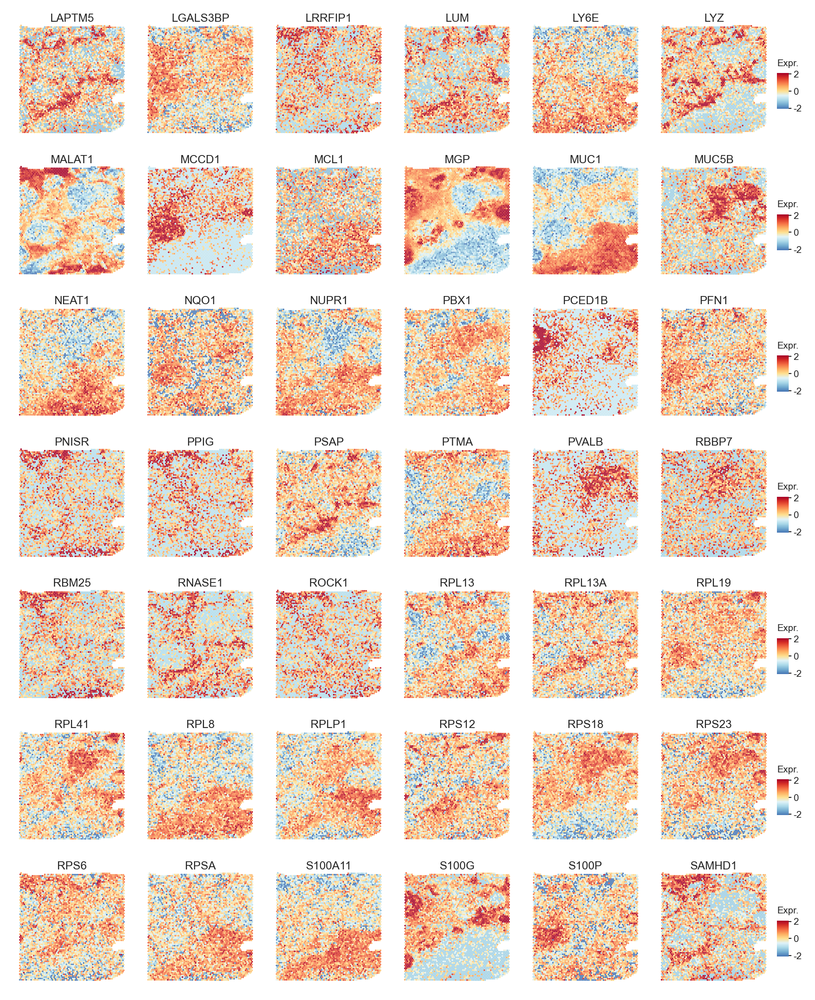

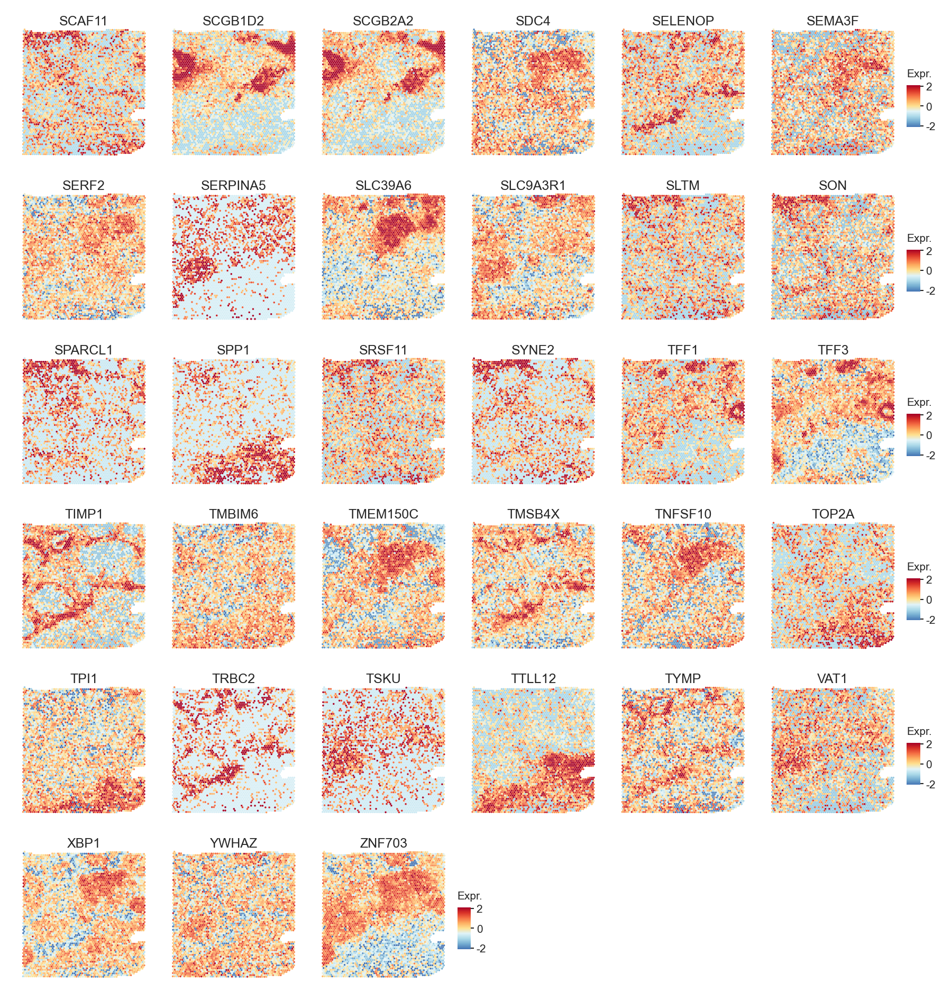

In [17]:
n_genes_page = 42

title_w_domain = False
if title_w_domain: 
    _domain_genes = to_matrix(svgs_1['gene'].tolist(), n_genes_page)
    _target_domain = to_matrix(svgs_1['domains'].tolist(), n_genes_page)
else:
    svgss = svgs_1.sort_values('gene')
    _domain_genes = to_matrix(svgss['gene'].tolist(), n_genes_page)
    _target_domain = to_matrix(svgss['domains'].tolist(), n_genes_page)
    
for i in range(len(_domain_genes)):
    svgplot(adata, genes=_domain_genes[i], frameon=False, panel_cbar=False, target_domain=_target_domain[i],cbar_wid_r=0.1, ncols=6,add_edge=False,
        axes_w_cm=3, size=1.5, domain_edge_alpha=200,img_key=None, cmap=newcmp_r_svg_pattern, wspace=0.001, hspace=0.01,title_w_domain=title_w_domain)
    plt.savefig(os.path.join(wk_root, f'notebook/results/SVG/svg_IDC_{i}_{n_genes_page}.pdf'), bbox_inches='tight', format='pdf', dpi=400)